In [1]:
%matplotlib inline
import copy
import h5py
import json
import math
import numpy as np
import os
import re
import subprocess
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Dense, Dropout
from keras.optimizers import Adam, SGD
from keras.preprocessing import image
from keras.backend.tensorflow_backend import set_session
from keras.metrics import top_k_categorical_accuracy
from PIL import Image
from scipy.spatial.distance import cosine as cosine_distance
from matplotlib.pyplot import imshow
import matplotlib.pyplot as plt
import matplotlib.colors as mcolor
from tqdm import tqdm

config = tf.ConfigProto()
config.gpu_options.per_process_gpu_memory_fraction = 0.25
set_session(tf.Session(config=config))

Using TensorFlow backend.


In [2]:
def list_to_dict(objs):
    dobj = {}
    for i, obj in enumerate(objs):
        dobj[obj] = i
        
    return dobj

In [3]:
raw_objects = ['person','bicycle','car','motorbike','aeroplane','bus','train','truck','boat','traffic light','fire hydrant','stop sign','parking meter','bench','bird','cat','dog','horse','sheep','cow','elephant','bear','zebra','giraffe','backpack','umbrella','handbag','tie','suitcase','frisbee','skis','snowboard','sports ball','kite','baseball bat','baseball glove','skateboard','surfboard','tennis racket','bottle','wine glass','cup','fork','knife','spoon','bowl','banana','apple','sandwich','orange','broccoli','carrot','hot dog','pizza','donut','cake','chair','sofa','pottedplant','bed','diningtable','toilet','tvmonitor','laptop','mouse','remote','keyboard','cell phone','microwave','oven','toaster','sink','refrigerator','book','clock','vase','scissors','teddy bear','hair drier','toothbrush']

In [4]:
objdict = list_to_dict(raw_objects)

In [5]:
n_classes = 80
def multi_hot(ds):
    a = np.zeros(n_classes)
    
    for di, dv in ds.items():
        a[objdict[di]] = dv
        
    return a

In [6]:
nclass = 4
def to_one_hot(m, ns):
    p = np.zeros((m, nclass), dtype=int)
    
    for i, n in enumerate(ns):
        p[i, n-1] = 1
    
    return p

In [7]:
def resample(a, t):
    n = np.zeros(t)
    l = len(a)
    f = l / t
    
    for i in range(0, t):
        lb = math.ceil(i * f)
        ub = math.floor((i + 1) * f) + 1
        n[i] = np.mean(a[lb:ub])
        
    return n

In [8]:
def redistribute(a, t, i):
    rd = np.zeros(t)
    half = int(t / 2)
    rd_pos = 0
    
    for k in range(i - half, i):
        if k >= 0:
            rd[rd_pos] = a[k]
            
        rd_pos = rd_pos + 1
        
    for k in range(i + 1, i + half + 1):
        if k < len(a):
            rd[rd_pos] = a[k]
        rd_pos = rd_pos + 1
        
    return rd

In [9]:
base_path = '/home/gbudiman/Documents/effigy/figs'
max_val = 352 * 288

def stringify(i):
    return 'fig{0:08d}.jpg'.format(i)

def get_integer(s):
    match = re.match(r'fig(\d+)\.jpg', s)

    if match: return int(match.group(1))
    else: return None
        
def open_image_as_array(video, frame):
    im = Image.open(os.path.join(base_path, video, frame))
    return np.asarray(im, dtype=float) / 255

def get_hsl_stats(video, frames):
    hues = []
    sats = []
    lvs = []

    for frame in frames:
        ia = open_image_as_array(video, stringify(frame[0]))
        hue, sat, lv = get_hsl(ia)
        hues.append(hue)
        sats.append(sat)
        lvs.append(lv)

    sats_max = np.max(sats)
    lvs_max = np.max(lvs)

    return hues, np.array(sats) / sats_max, np.array(lvs) / lvs_max

def get_hsl(a):
    hsv = mcolor.rgb_to_hsv(a)

    hue = np.sum(hsv[:,:,0])
    saturation = np.sum(hsv[:,:,1])
    lightness = np.sum(hsv[:,:,2])

    return hue / max_val, saturation / max_val, lightness / max_val

In [10]:
def load_data(movies):
    Xs = []
    moviescenes = {}
    
    for movie in movies:
        file = 'features_' + movie + '.h5'
        hf = h5py.File(file, 'r')
        
        framelist = np.array(hf.get('frames'))
        features = np.array(hf.get('features'))
        
        moviescenes[movie] = framelist
        arr_features = []
        arr_dist = []
        for idx, feature in enumerate(features):
            feature = np.array(feature)
            
            dist = []
            for cmp_feature in features:
                dist.append(cosine_distance(feature, cmp_feature))
                
            #dist = np.array(dist)
            #resampled = resample(dist, 24)
            resampled = redistribute(dist, 24, idx)
            #dist = np.array(resampled)
            #stage = np.append(feature, dist)
            #Xs.append(stage)
            arr_features.append(feature)
            arr_dist.append(resampled)
            
        arr_yolo = build_yolo_jobs(movie, framelist)
        hues, sats, lvs = get_hsl_stats(movie, framelist)
        
        #print(arr_features)
        #print(arr_dist)
        #print(arr_yolo)
        for z in zip(arr_features, arr_dist, arr_yolo, hues, sats, lvs):
            #fl = np.array(z[0])
            fl = np.array(z[1])
            #fl = np.append(fl, z[1])
            fl = np.append(fl, z[2])
            fl = np.append(fl, z[3])
            fl = np.append(fl, z[4])
            fl = np.append(fl, z[5])
            Xs.append(fl)

    
    return np.array(Xs), framelist

In [11]:
base_path = '/home/gbudiman/Documents/effigy/figs'

def stringify(i):
    return 'fig{0:08d}.jpg'.format(i)

def build_yolo_jobs(movie, f):
    paths = []
    for frames in f:
        for _frame in frames:
            paths.append(stringify(_frame))
            
    return launch_yolo(movie, paths)
        
def launch_yolo(movie, _paths):
    paths = ' '.join(_paths)
    multi_hots = []
    cmd = ['/home/gbudiman/Documents/darknet/darknet',
           'batch_detect',
           '/home/gbudiman/Documents/darknet/cfg/yolo.cfg',
           '/home/gbudiman/Documents/darknet/yolo.weights',
           os.path.join(base_path, movie),
           paths]
    
    os.system(' '.join(cmd) + ' > tmp')
    for detection in parse_tmp_file():
        multi_hots.append(multi_hot(detection))
        
    return multi_hots
    
def parse_tmp_file():
    state = None
    result = []
    
    with open('tmp', 'r') as fp:
        content = fp.readlines()
        header_pattern = r'Predicted in'
        detection_pattern = r'^([\w\s]+)\: (\d+)'
        area_pattern = r'^(\d+) (\d+) (\d+) (\d+)'
        container = {}
        area = 0
        confidence = 0
        object_name = None
        
        for _line in content:
            line = _line.strip()
            header_match = re.search(header_pattern, line)
            detection_match = re.match(detection_pattern, line)
            area_match = re.match(area_pattern, line)
            
            if header_match:
                if state is not None:
                    result.append(container)
                    container = {}
                    
                state = 'frame'
            elif detection_match:
                object_name = detection_match.group(1)
                confidence = float(detection_match.group(2)) / 100
                state = 'object'
                
                if object_name not in container:
                    container[object_name] = 0
                
            elif area_match:
                tl0, tl1 = int(area_match.group(1)), int(area_match.group(2))
                br0, br1 = int(area_match.group(3)), int(area_match.group(4))
                area = abs(tl0 - br0) * abs(tl1 - br1) / (352 * 288)
                state = 'area'

                composite = area * confidence
                if composite > container[object_name]:
                    container[object_name] = composite
                    
        result.append(container)
                
    
    return result
        

In [12]:
movies = ['apple', 'disney', 'hussein_day1', 'michael_day2', 'usc_week']
Xs, _unused = load_data(movies)
y_apple         = [2,1,3,4,3,1,3,2,1,4,3,4,1,2,3,4,3,3,1,3,2,4,1,3,4,3,3,4,4,2,3,1,2,1,2,4,1,3,4,2,1,4,3]
#y_apple         = []
y_disney        = [4,1,1,3,1,4,3,1,4,4,2,3,1,3,4,2,4,1,4,1,3,4,4,3,3,1,1,2,1,1,2,3,3,4,1,2,1,4,4,3,1,2,1,3,1,3]
y_hussein_day1  = [1,3,1,4,3,2,3,1,2,3,4,3,1,3,2,4,3,4,1,4,4,4,1,3,4,2,4,4,3,4,2,4,4,4,4,2,2,4,3,2,2,2,3,2,2,2,4,3,4,4,4,1]
y_michael_day2  = [2,4,4,3,3,2,4,2,4,4,4,3,4,2,4,4,4,4,4,4,3,4,3,4,4,4,2,2,1,3,3,4,4,4,3,1,3,1,1,1,2,4,1,1,1]
y_usc_week      = [3,2,4,4,4,1,4,4,4,4,4,1,3,2,1,3,2,1,4,4,4,3,1,2,4,3,3,2,4,1,1,2,3,2,4,4,4,4,2,1,2,1,2,3,2,1,2,4,4,2]

y = y_apple + y_disney + y_hussein_day1 + y_michael_day2 + y_usc_week
Ys = to_one_hot(len(y), y)

In [13]:
def top_2_categorical_accuracy(y_true, y_pred):
    return top_k_categorical_accuracy(y_true, y_pred, k=2)

def generate_model():
    sgd = SGD(lr=0.01, momentum=0.8, decay=0.0)
    model = Sequential()
    #model.add(Dense(4, input_shape=(24 + 80 + 3,), activation='softmax', kernel_initializer='random_uniform', bias_initializer='zeros'))
    
    model.add(Dense(16, input_shape=(24 + 80 + 3,), activation='softmax', kernel_initializer='random_uniform', bias_initializer='zeros'))
    model.add(Dropout(0.2))
    model.add(Dense(4, input_shape=(16,), activation='softmax', kernel_initializer='random_uniform', bias_initializer='zeros'))
    model.summary()
    model.compile(Adam(lr=0.01), loss='categorical_crossentropy', metrics=['accuracy'])
    
    return model

In [14]:
model = generate_model()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 16)                1728      
_________________________________________________________________
dropout_1 (Dropout)          (None, 16)                0         
_________________________________________________________________
dense_2 (Dense)              (None, 4)                 68        
Total params: 1,796.0
Trainable params: 1,796.0
Non-trainable params: 0.0
_________________________________________________________________


In [15]:
model.fit(Xs, Ys, epochs=100000, batch_size=32)

Epoch 1/100000
236/236 [==============================] - 0s - loss: 1.3799 - acc: 0.3263     
Epoch 2/100000
236/236 [==============================] - 0s - loss: 1.3648 - acc: 0.3517     
Epoch 3/100000
236/236 [==============================] - 0s - loss: 1.3605 - acc: 0.3517     
Epoch 4/100000
236/236 [==============================] - 0s - loss: 1.3603 - acc: 0.3517     
Epoch 5/100000
236/236 [==============================] - 0s - loss: 1.3602 - acc: 0.3517     
Epoch 6/100000
236/236 [==============================] - 0s - loss: 1.3593 - acc: 0.3517     
Epoch 7/100000
236/236 [==============================] - 0s - loss: 1.3555 - acc: 0.3517     
Epoch 8/100000
236/236 [==============================] - 0s - loss: 1.3585 - acc: 0.3517     
Epoch 9/100000
236/236 [==============================] - 0s - loss: 1.3603 - acc: 0.3517     
Epoch 10/100000
236/236 [==============================] - 0s - loss: 1.3569 - acc: 0.3517     
Epoch 11/100000
236/236 [========================

In [16]:
#test_movies = ['disney']
#As, ss = load_data(test_movies)

#Bs = model.predict(As)

In [17]:
def index_selector_equal(n, arrays, probs):
    result = []
    values = []
    for i, a in enumerate(arrays):
        if a == n:
            result.append(i)
            values.append(probs[i,n])
            
    return result, values

def masked_argmin(arrays, masks):
    min_index = -1
    min_value = 2
    for i, z in enumerate(zip(arrays, masks)):
        value = z[0]
        mask = z[1]
        
        if mask == 0 and value < min_value:
            min_value = value
            min_index = i
    
    return min_index

def window_regularizer(predictions, argmax, window_size=8):
    windows = []
    slack = len(argmax) % window_size

    for w in range(0, len(argmax) - slack, window_size):
        w_pred = predictions[w:w+window_size]
        w_res = argmax[w:w+window_size]
        
        #print(w_res)
        #print(w_pred)
        change_map = np.zeros(window_size, dtype=int)
        w_average = np.mean(w_res)
        while w_average > 1.6:
            wd = np.bincount(w_res)
            #print(w, w+window_size, w_average)
            #print(w_pred)
            #print(w_res)
            #print(wd)

            #step_down_index = np.argmax(wd)
            max_point = np.argmax(wd)
            #print('max_point = ', max_point)
            maxes, vals = index_selector_equal(max_point, w_res, w_pred)
            max_count = len(maxes)
            #print(maxes)
            #print(vals)
            
            min_prob_index = np.argmin(vals)#masked_argmin(vals, change_map)
            min_prob = maxes[min_prob_index]
            w_res[min_prob] = w_res[min_prob] - 1
            change_map[min_prob] = 1
            for m in range(0, w_res[min_prob] + 1):
                w_pred[min_prob, m] = 1
            
            
            #print('Step down')
            #print(w_res)
            #print(w_pred)
            #print(change_map)
            w_average = np.mean(w_res)
            
        while w_average < 1.4:
            wd = np.bincount(w_res)
            #step_up_index = np.argmax(wd)
            min_point = np.argmax(wd)
            mins, vals = index_selector_equal(min_point, w_res, w_pred)
            min_count = len(mins)
            
            min_prob_index = np.argmin(vals)
            min_prob = mins[min_prob_index]
            w_res[min_prob] = w_res[min_prob] + 1
            for m in range(w_res[min_prob], 4):
                w_pred[min_prob, m] = 1
                
            #print('Step up')
            #print(w_res)
            w_average = np.mean(w_res)
        
        for r in w_res:
            windows.append(r)
            
    for w in range(len(argmax) - slack, len(argmax)):
        windows.append(argmax[w])
        
        
    return np.array(windows)

In [31]:
def dump_ranked_keyframes(movie, data):
    folder_path = os.path.join(base_path, movie, 'ranked_keyframes.json')
    with open(folder_path, 'w') as f:
        json.dump(data, f)
        
    print('Ranked keyframe dumped to {0:s}'.format(folder_path))
        
def predict_movie(m):
    As, ss = load_data([m])
    Bs = model.predict(As)
    b_copy = copy.deepcopy(Bs)
    res = np.argmax(b_copy, axis=1)
    regz = window_regularizer(b_copy, copy.deepcopy(res), window_size=8)
    ranked_keyframes = {}
    
    for z in zip(ss, res, regz):
        plt.figure()
        frame_s = stringify(z[0][0])
        ia = open_image_as_array(m, frame_s)
        imshow(ia)
        plt.title('{0:s}: {1:d} => {2:d}'.format(frame_s, z[1] + 1, z[2] + 1))
        ranked_keyframes[frame_s] = {
            'r': int(z[2]),
            't': (get_integer(frame_s) / 20)
        }
        
    dump_ranked_keyframes(m, ranked_keyframes)

/home/gbudiman/anaconda3/envs/effigy/lib/python3.6/site-packages/matplotlib/pyplot.py:523: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


Ranked keyframe dumped to /home/gbudiman/Documents/effigy/figs/apple/ranked_keyframes.json


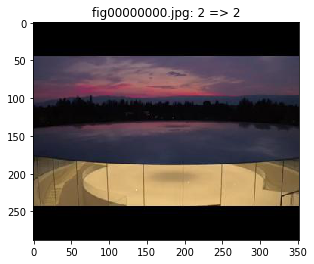

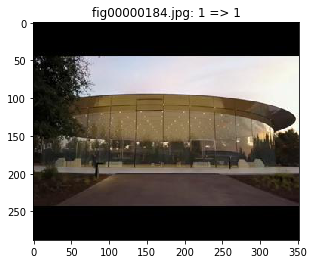

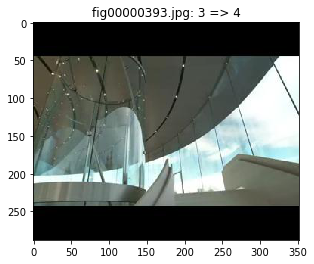

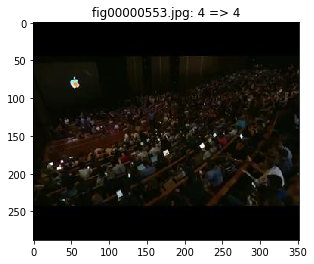

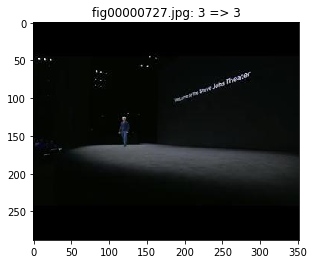

...

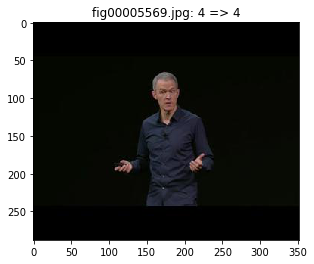

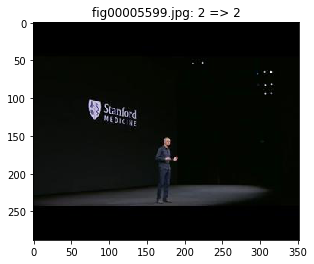

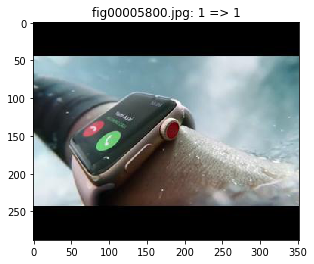

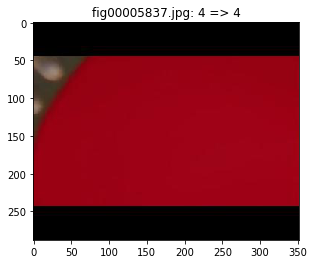

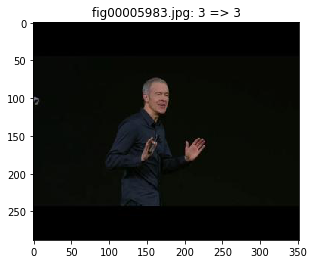

In [32]:
predict_movie('apple')

/home/gbudiman/anaconda3/envs/effigy/lib/python3.6/site-packages/matplotlib/pyplot.py:523: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


Ranked keyframe dumped to /home/gbudiman/Documents/effigy/figs/disney/ranked_keyframes.json


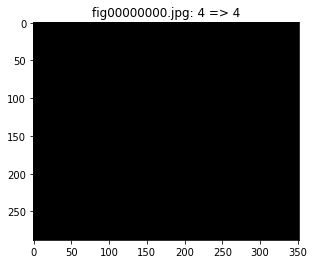

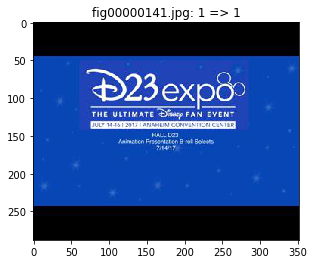

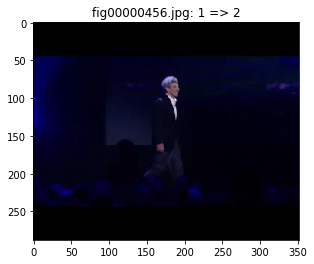

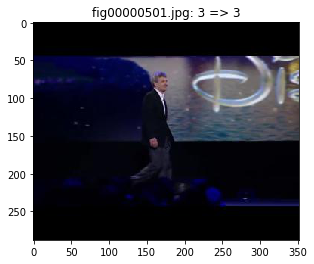

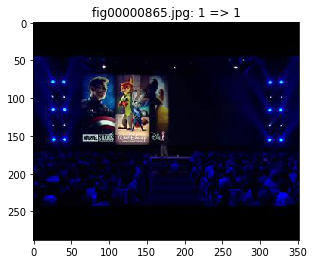

...

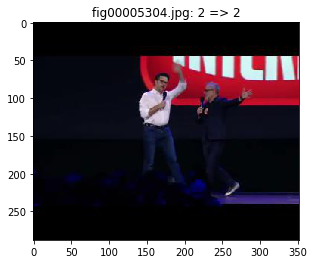

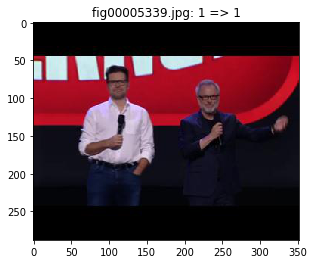

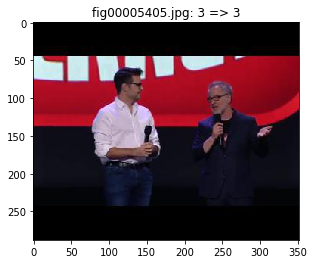

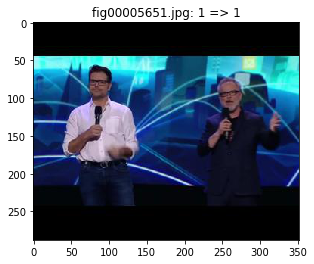

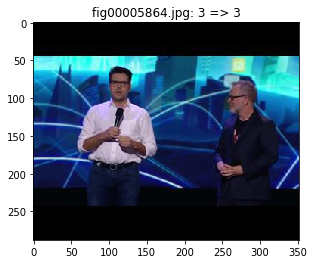

In [20]:
predict_movie('disney')

/home/gbudiman/anaconda3/envs/effigy/lib/python3.6/site-packages/matplotlib/pyplot.py:523: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


Ranked keyframe dumped to /home/gbudiman/Documents/effigy/figs/usc_week/ranked_keyframes.json


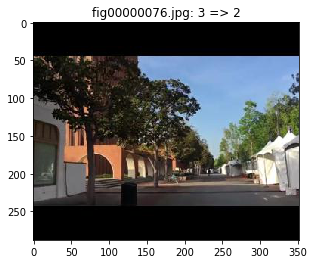

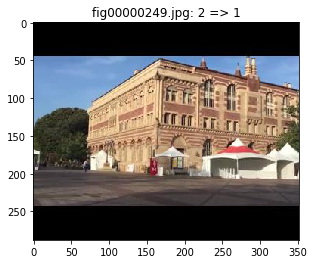

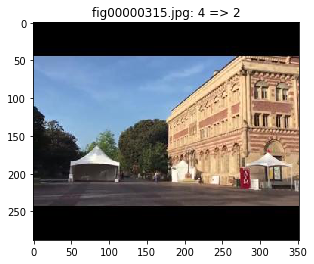

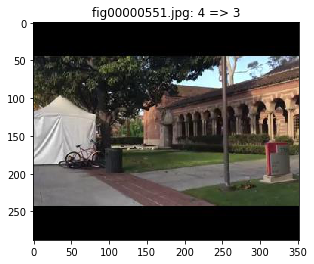

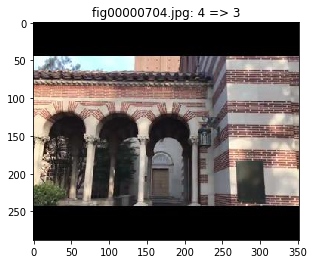

...

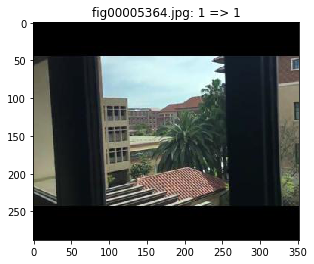

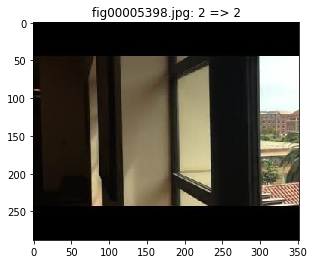

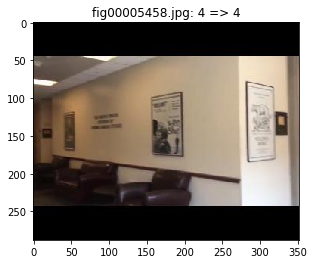

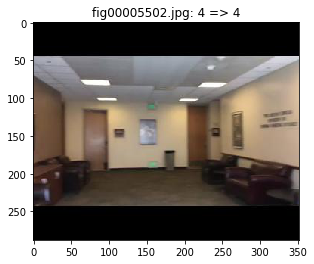

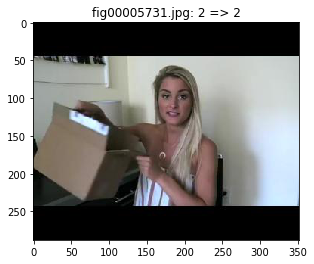

In [21]:
predict_movie('usc_week')

/home/gbudiman/anaconda3/envs/effigy/lib/python3.6/site-packages/matplotlib/pyplot.py:523: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


Ranked keyframe dumped to /home/gbudiman/Documents/effigy/figs/michael_day2/ranked_keyframes.json


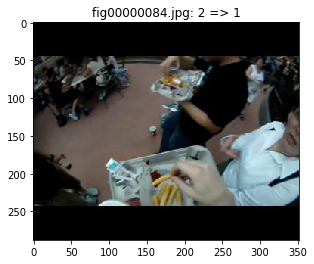

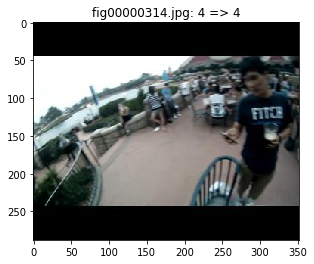

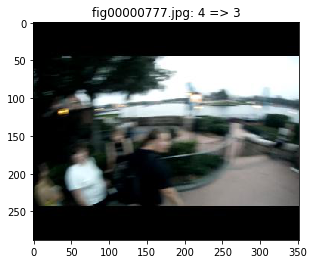

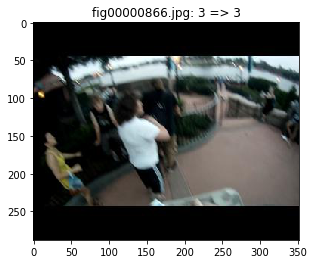

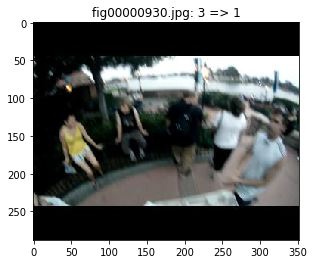

...

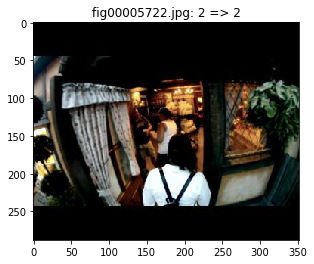

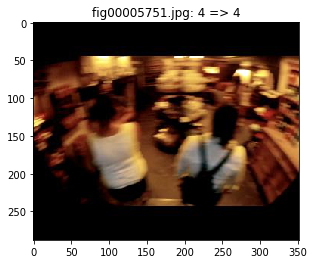

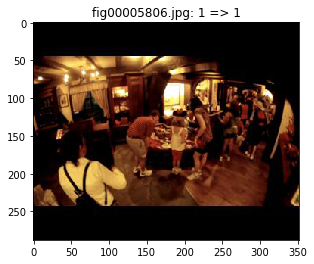

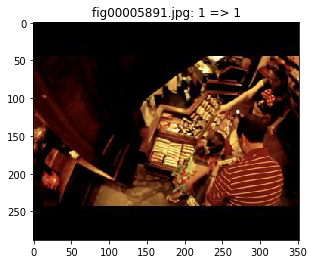

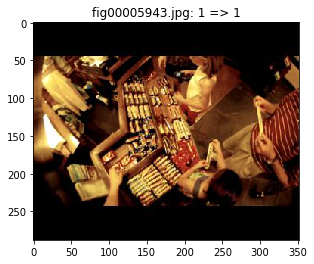

In [22]:
predict_movie('michael_day2')

/home/gbudiman/anaconda3/envs/effigy/lib/python3.6/site-packages/matplotlib/pyplot.py:523: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


Ranked keyframe dumped to /home/gbudiman/Documents/effigy/figs/hussein_day1/ranked_keyframes.json


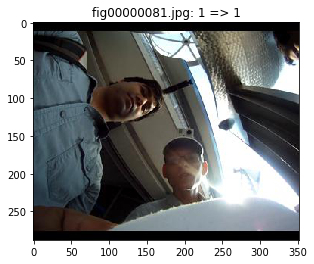

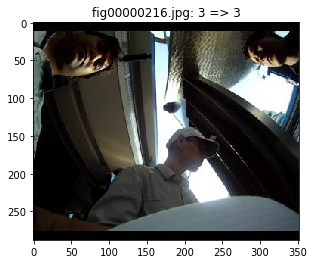

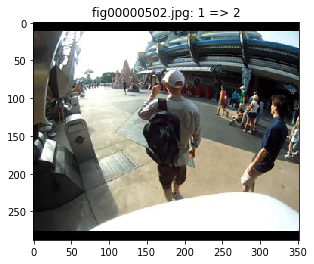

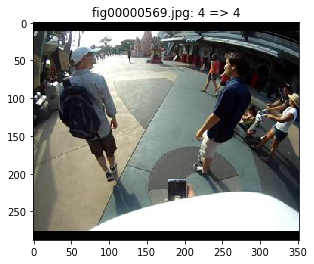

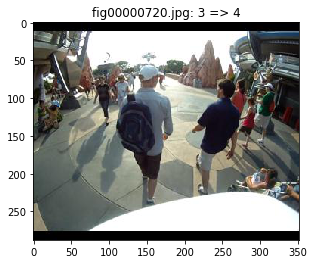

...

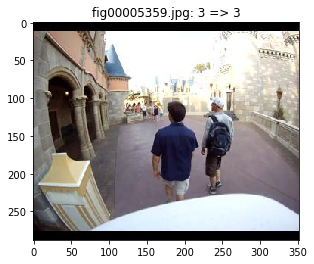

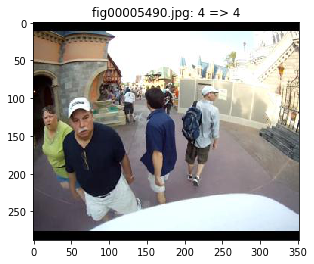

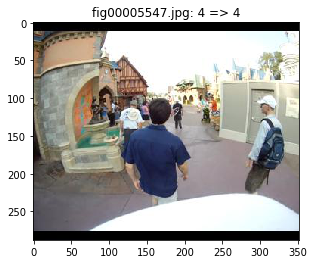

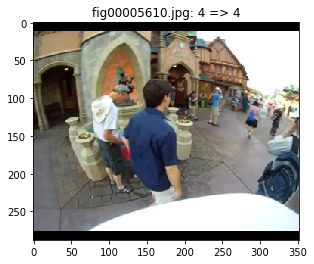

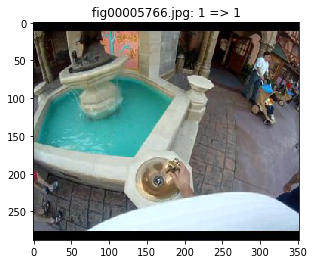

In [23]:
predict_movie('hussein_day1')